In [1]:
import sys
help(sys.path.append)

Help on built-in function append:

append(object, /) method of builtins.list instance
    Append object to the end of the list.



In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os, sys, glob
import numpy as np
import scipy
from collections import OrderedDict
sys.path.insert(0, os.path.abspath('Code/consmod'))
import compute
%matplotlib inline

In [3]:
cpac_dir = os.path.join('cpac/pipeline_default')
cpac_suf = os.path.join('roi_timeseries','_scan_rest',
	'_compcor_ncomponents_5_selector_pc10.linear1.wm1.global0.motion1.quadratic1.gm0.compcor1.csf1', '_bandpass_freqs_0.01.0.1',
	'_mask_Schaefer2018_400_7N_MNI152_2mm_mask_file_..rois..Schaefer2018_400_7N_MNI152_2mm.nii.gz','roi_stats.csv')
yeo_info = pd.read_csv('Schaefer2018_400Parcels_7Networks_order.txt',
                          sep='\t',header=None)
yeo_info['network'] = yeo_info[1].str.split('_').str.get(2) 
yeo_info['network_id'] = yeo_info.network.astype("category").cat.codes
exclude_limbic = np.where((yeo_info['network']=='Limbic').values)[0] 
n_nodes = yeo_info.shape[0] - exclude_limbic.size
CI_yeo = np.reshape(yeo_info.loc[(yeo_info['network']!='Limbic'),'network_id'].values,(n_nodes,1))
yeo_no_limbic = yeo_info.loc[(yeo_info['network']!='Limbic'),]					
demo_info_i = pd.read_excel('BlindedCognitiveData_wTauIDs.xlsx')
demo_include = pd.read_excel('BlindedCognitiveData_wTauIDs.xlsx', sheet_name= 1)
#sids = ['B-01CSF5','B-1QIHWL','B-OKWWG6']
print(demo_include)
include = np.array(demo_include) == 1
demo_info = demo_info_i.loc[:, include[0]]
demo_info.head()

SubjIDshort  ID_Complete  Group  SEX  EDU  AGE  mmsetime  mmselocation  \
0            1            1      1    1    1    1         0             0   

   mmsememory  mmseattention  ...  Fast  EDG  PIB_FS_DVR_PVC_FLR-float  \
0           1              0  ...     0    0                         1   

   TAU_FS_SUVR_PVC_entorhinal_lh  TAU_FS_SUVR_PVC_entorhinal_rh  \
0                              1                              1   

   TAU_FS_SUVR_PVC_entorhinal_bh  TAU_FS_SUVR_PVC_inferiortemporal_lh  \
0                              1                                    1   

   TAU_FS_SUVR_PVC_inferiortemporal_rh  TAU_FS_SUVR_PVC_inferiortemporal_bh  \
0                                    1                                    1   

   TAU_FS_SUVR_PVC_precuneus_bh  
0                             1  

[1 rows x 155 columns]


,SubjIDshort,ID_Complete,Group,SEX,EDU,AGE,mmsememory,mmserecall,mmsetotal,FluTot,...,WisEr,IneTot30,PIB_FS_DVR_PVC_FLR-float,TAU_FS_SUVR_PVC_entorhinal_lh,TAU_FS_SUVR_PVC_entorhinal_rh,TAU_FS_SUVR_PVC_entorhinal_bh,TAU_FS_SUVR_PVC_inferiortemporal_lh,TAU_FS_SUVR_PVC_inferiortemporal_rh,TAU_FS_SUVR_PVC_inferiortemporal_bh,TAU_FS_SUVR_PVC_precuneus_bh
0,B_01CSF5,B_01CSF5_2102-04-13,1,2,5,45,3,3,29,19,...,13.0,20.5,1.1574,1.07750,1.28530,1.18780,1.3399,1.17280,1.2633,1.17930
1,B_12BJNE,B_12BJNE_2240-09-23,1,2,16,35,3,2,29,28,...,12.0,26.0,1.0863,1.23340,0.97620,1.10890,1.2608,1.11930,1.1877,1.13980
2,B_1QIHWL,B_1QIHWL_2184-08-23,1,1,12,29,3,2,29,19,...,16.0,26.0,1.1333,0.72157,0.88275,0.80733,1.2900,1.16740,1.2264,1.01000
3,B_1Z6OLO,B_1Z6OLO_2115-04-12,1,2,12,44,3,2,29,19,...,22.0,25.5,1.1340,1.03400,1.10630,1.07220,1.0109,1.01680,1.0137,0.93585
4,B_2W53GU,B_2W53GU_2146-05-23,1,1,11,27,3,0,26,19,...,19.0,21.0,1.0694,1.05160,1.16970,1.11220,1.0675,0.99313,1.0278,0.96680


## Get mni coords

In [4]:
yeo_cords = pd.read_csv('Schaefer2018_400Parcels_7Networks_order_FSLMNI152_2mm.Centroid_RAS.csv',
							sep=',',header=None)
yeo_cords_no_limbic = yeo_cords.loc[yeo_no_limbic[0],]
coords= yeo_cords_no_limbic.iloc[:, 2:5].values
networks = yeo_cords_no_limbic.iloc[:, 1:2].values


## All groups together


In [5]:
import re
import nilearn.plotting as niplot
from numpy import genfromtxt
ffnn = glob.glob(cpac_dir+'/*') 
n_sub = len(ffnn)
gx_info = np.empty(n_sub)
CM = np.array([])
sel_demo_info=pd.DataFrame(columns=list(demo_info.columns))
i = 0
for i in range(n_sub):
    fn = ffnn[i]
    sid = re.search('(?<=-B)\w+(?=_)',fn).group(0)
    gx_id= demo_info.loc[(demo_info['SubjIDshort']=='B_'+sid),'Group' ].tolist()[0]
    cm_fn = os.path.abspath(os.path.join(fn,cpac_suf))
    ts = genfromtxt(cm_fn,delimiter='\t',skip_header=1)
    cm = compute.con_mat(cm_fn,fisher_z=True,exclude_nodes=exclude_limbic)
    CM = np.append(np.atleast_3d(CM),np.atleast_3d(cm),axis=2) if CM.size else cm
    gx_info[i] = gx_id 
    if not sum((demo_info['SubjIDshort']=='B_'+sid)): print(sid+' not found')
    sel_demo_info = sel_demo_info.append(demo_info[(demo_info['SubjIDshort']=='B_'+sid)],ignore_index=True)

In [6]:
import statistics
import bct
from scipy.stats import pointbiserialr

len_sel_demo = len(sel_demo_info.columns[3:])
all_thr_df = pd.DataFrame(columns={'ind','metric','node_id','group','str_fc','str_behav'})
all_corr_th = pd.DataFrame(columns={'colname','corr_matrix','strenght','group'})
all_edges = compute.vectorize_3d_cm(CM)
col_demo = [] 
for col_name in sel_demo_info.columns[3:]:
  sel_met = sel_demo_info[col_name].values
  null_index = sel_demo_info.loc[pd.isna(sel_met), :].index
  not_null_index = np.delete(np.arange(len(sel_met)),null_index) 
  n_sel_met= np.delete(sel_met, null_index.values, axis=0)
  n_CM= np.delete(CM,null_index.values, axis=2)
  n_gx_info = np.delete(gx_info,null_index.values, axis=0)
  n_n_sub = len(n_gx_info)
  col_demo.append(col_name)
  edges = compute.vectorize_3d_cm(n_CM)
  mcorr_sm = compute.multimodal_corr(edges,n_sel_met,corr=pointbiserialr) if col_name=="SEX" else compute.multimodal_corr(edges,n_sel_met)
  cm_sm = np.nan_to_num(compute.vectorize_3d_cm_inv(mcorr_sm['r'],n_nodes))
  p_mask = compute.vectorize_3d_cm_inv(mcorr_sm['p'],n_nodes)
  p_mask[(p_mask>0.05) | (cm_sm<0)]=0
  p_mask[(p_mask<=0.05) & (cm_sm>0)]=1
  CMmask = np.zeros(n_CM.shape)
  CMmask[:,:,:] = p_mask[:,:,np.newaxis] > 0
  CM_masked = n_CM*CMmask
  v_cm_masked = compute.vectorize_3d_cm(CM_masked)
  edges_sum = v_cm_masked.sum(axis=1)
  cm_masked_n_mean = np.nan_to_num(CM_masked)
 
  cm_sm_masked_streght = bct.strengths_und(cm_masked_n_mean)
  
  corr_th = pd.DataFrame([{'colname': col_name, 'corr_matrix': cm_masked_n_mean, 'strenght': cm_sm_masked_streght , 'group': n_gx_info, 'str_behav': n_sel_met}]) 
  all_corr_th = pd.concat([all_corr_th, corr_th], ignore_index = True)               
  
  all_thr_df =  pd.concat([all_thr_df,
                              pd.DataFrame({'ind': not_null_index, 'metric':np.repeat(col_name,n_n_sub),'node_id':np.arange(1,n_n_sub+1),
                                            'group':n_gx_info,'str_fc':edges_sum,
                                            'str_behav':n_sel_met})],
                             ignore_index = True)   


#### Z score

In [7]:
from scipy import stats
#all_thr_df.loc[~np.isnan(all_thr_df['str_fc']),'str_fc'] = stats.zscore(all_thr_df.loc[~np.isnan(all_thr_df['str_fc']),'str_fc'])
#all_thr_df.loc[~pd.isnull(all_thr_df['str_behav']),'str_behav'] = stats.zscore(all_thr_df.loc[~pd.isnull(all_thr_df['str_behav']),'str_behav'])

In [8]:
df_filter_i = all_thr_df[(all_thr_df.group != 3)]
df_filter = df_filter_i[df_filter_i.metric != "SEX"]

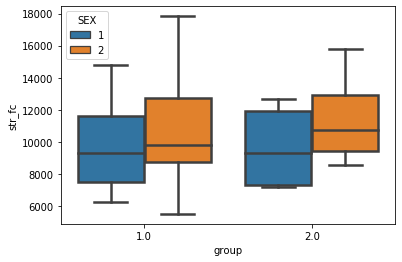

In [9]:
th_sex = df_filter_i[df_filter_i.metric=="SEX"]
th_sex = th_sex.rename(columns = {'str_behav':'SEX'})  
ax = sns.boxplot(x="group", y="str_fc", hue="SEX",data=th_sex, linewidth=2.5)

In [10]:
import numpy, pandas, researchpy as rp
rp.summary_cont(th_sex.groupby(['group', 'SEX']))['str_fc']

N          Mean           SD          SE    95% Conf.  \
group SEX                                                           
1.0   1    14   9687.140625  2560.599633  684.349038  8345.816511   
      2    12  10630.611583  3427.588057  989.459444  8691.271073   
2.0   1     8   9656.393140  2379.337964  841.223004  8007.596052   
      2    10  11279.946817  2385.188499  754.262830  9801.591669   

               Interval  
group SEX                
1.0   1    11028.464739  
      2    12569.952093  
2.0   1    11305.190229  
      2    12758.301964

## Two-way anova sex and group

In [11]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
import statsmodels.stats.multicomp

model = ols('str_fc ~ C(group)*C(SEX)', th_sex).fit()

# Seeing if the overall model is significant
print(f"Overall model F({model.df_model: .0f},{model.df_resid: .0f}) = {model.fvalue: .3f}, p = {model.f_pvalue: .4f}")
model.summary()

Overall model F( 3, 40) =  0.851, p =  0.4743


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 str_fc   R-squared:                       0.060
Model:                            OLS   Adj. R-squared:                 -0.011
Method:                 Least Squares   F-statistic:                    0.8510
Date:                Tue, 31 Mar 2020   Prob (F-statistic):              0.474
Time:                        14:57:56   Log-Likelihood:                -408.99
No. Observations:                  44   AIC:                             826.0
Df Residuals:                      40   BIC:                             833.1
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
===============================================================================================
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept                    9687.1406    738.362     13.120      0.000    8194.856    1.12e+04
C(group)[T.2.0]               -30.7475   1224.434     -0.025      0.980   -2505.421    2443.926
C(SEX)[T.2]                   943.4710   1086.839      0.868      0.391   -1253.112    3140.054
C(group)[T.2.0]:C(SEX)[T.2]   680.0827   1702.506      0.399      0.692   -2760.811    4120.977
==============================================================================
Omnibus:                        2.310   Durbin-Watson:                   1.423
Prob(Omnibus):                  0.315   Jarque-Bera (JB):                2.056
Skew:                           0.517   Prob(JB):                        0.358
Kurtosis:                       2.775   Cond. No.                         6.52
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [12]:
res = sm.stats.anova_lm(model, typ= 2)
res

,sum_sq,df,F,PR(>F)
C(group),1.086746e+06,1.0,0.142384,0.707917
C(SEX),1.624899e+07,1.0,2.128924,0.152351
C(group):C(SEX),1.217901e+06,1.0,0.159568,0.691679
Residual,3.052995e+08,40.0,NaN,NaN


In [13]:
th_sex_1 = th_sex[th_sex.group == 1]
th_sex_2 = th_sex[th_sex.group == 2]

In [14]:
model_sex1 = ols('str_fc ~ C(SEX)', th_sex_1).fit()
model_sex2 = ols('str_fc ~ C(SEX)', th_sex_2).fit()

# Seeing if the overall model is significant
print(f"Overall model for group 1  SEX F({model_sex1.df_model: .0f},{model_sex1.df_resid: .0f}) = {model_sex1.fvalue: .3f}, p = {model_sex1.f_pvalue: .4f}")
print(f"Overall model for group 2 SEX F({model_sex2.df_model: .0f},{model_sex2.df_resid: .0f}) = {model_sex2.fvalue: .3f}, p = {model_sex2.f_pvalue: .4f}")

Overall model for group 1  SEX F( 1, 24) =  0.644, p =  0.4303
Overall model for group 2 SEX F( 1, 16) =  2.064, p =  0.1701


## LM PLOTS

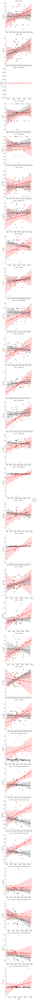

In [15]:

lm_fc_scr=sns.lmplot(x="str_fc", y="str_behav", row="metric", hue= "group",
                     palette=['black','red'], sharex=False,sharey=False,data=df_filter)

In [16]:
#n_col_demo = len(col_demo)
#lm_fc_scr = sns.lmplot(x="str_fc", y="str_behav", col="metric", 
#         sharex=False,sharey=False,data=df_filter,col_wrap=1)

#for i in range(n_col_demo):
#  sns.scatterplot(x="str_fc",y="str_behav",data=df_filter.loc[df_filter["metric"]==col_demo[i],:],hue="group", palette=['black','red'], ax=lm_fc_scr.axes[i])
#  lm_fc_scr.axes[i].set_ylabel(col_demo[i]+' [z-score]')
#  lm_fc_scr.axes[i].set_xlabel('FC [z-score]')

## Análisis multivariado


In [17]:
import numpy as np
import pingouin as pg

In [18]:
df_sex = sel_demo_info["SEX"]
df_age = sel_demo_info["AGE"]
new_col_demo = col_demo[1:]

for col in new_col_demo:
  df_col = df_filter[df_filter.metric==col]
  beh = df_col.str_behav
  fc = df_col.str_fc
  group = df_col.group
  age = df_age[df_col.ind]
  sex = df_sex[df_col.ind]
  X = pd.DataFrame({"FC": fc.values, "GROUP": group.values}).astype('float64') 
  Y = np.array(df_col.str_behav.values, dtype=float)
  m = pg.linear_regression(X, Y)
  print("**********************************************************************")
  print()
  print()
  print("Y=",col)
  print(m.to_string())

**********************************************************************


Y= EDU
       names      coef        se         T      pval        r2   adj_r2  CI[2.5%]  CI[97.5%]
0  Intercept  7.557430  3.130720  2.413960  0.020331  0.027718 -0.01971  1.234814  13.880047
1         FC  0.000212  0.000196  1.081110  0.285967  0.027718 -0.01971 -0.000184   0.000609
2      GROUP  0.028843  1.262484  0.022847  0.981883  0.027718 -0.01971 -2.520794   2.578481
**********************************************************************


Y= AGE
       names       coef        se         T          pval        r2    adj_r2   CI[2.5%]  CI[97.5%]
0  Intercept  30.030483  3.654482  8.217438  3.338830e-10  0.089342  0.044919  22.650106  37.410860
1         FC   0.000485  0.000242  2.001770  5.195600e-02  0.089342  0.044919  -0.000004   0.000974
2      GROUP  -0.117954  1.520821 -0.077560  9.385556e-01  0.089342  0.044919  -3.189315   2.953406
********************************************************************

# statistical analysis  

http://gael-varoquaux.info/stats_in_python_tutorial/auto_examples/plot_wage_education_gender.html#example-plot-wage-education-gender-py

In [19]:
# statistical analysis
import statsmodels.api as sm
from statsmodels.formula.api import ols
import statsmodels.stats.multicomp

# We need to model this using an interaction
sig_dif = pd.DataFrame(columns={'col_name','p_int_value'})

for col in new_col_demo:
  print("**********************************************************************")
  print()
  print()
  print("Y=",col)
  df_col = df_filter[df_filter.metric==col]
  beh = df_col.str_behav
  fc = df_col.str_fc
  node_id = df_col.node_id
  group = np.choose(df_col.group.astype(int)-1, ['NC', 'C'])
  data = pd.DataFrame({"FC": fc.values, "beh": df_col.str_behav.values}).astype('float64') 
  data["group"] = group.values
  result = ols(formula='beh ~ FC + group + FC* group', data=data).fit()
  p_int = result.pvalues["FC:group[T.NC]"]
  if p_int < 0.05:
    sig_dif  =  pd.concat([sig_dif, pd.DataFrame({'col_name': col, 'p_int_value': p_int, 'r_adj': result.rsquared_adj, 'beh': beh, 'fc': fc, 'group': group, 'node_id': node_id})], ignore_index = True)
  res = sm.stats.anova_lm(result, typ= 2)
  print()
  print(res)
  print()
  print()


**********************************************************************


Y= EDU

              sum_sq    df         F    PR(>F)
group       0.008847   1.0  0.000526  0.981810
FC         19.810163   1.0  1.178680  0.284125
FC:group   22.633254   1.0  1.346650  0.252744
Residual  672.283078  40.0       NaN       NaN


**********************************************************************


Y= AGE

               sum_sq    df         F    PR(>F)
group        0.147908   1.0  0.005869  0.939316
FC          98.525218   1.0  3.909489  0.054935
FC:group     0.036398   1.0  0.001444  0.969874
Residual  1008.062315  40.0       NaN       NaN


**********************************************************************


Y= mmsememory

                sum_sq    df   F  PR(>F)
group              NaN   1.0 NaN     NaN
FC                 NaN   1.0 NaN     NaN
FC:group           NaN   1.0 NaN     NaN
Residual  1.423894e-28  42.0 NaN     NaN


****************************************************************

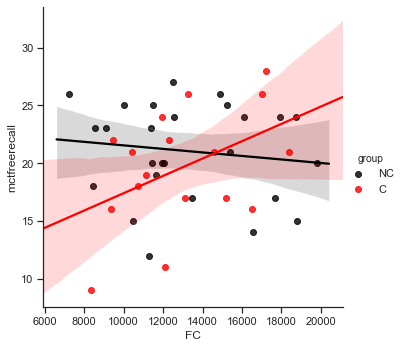

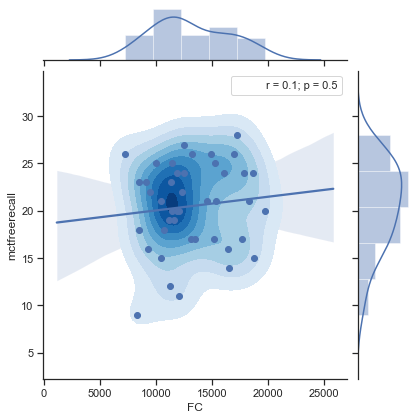

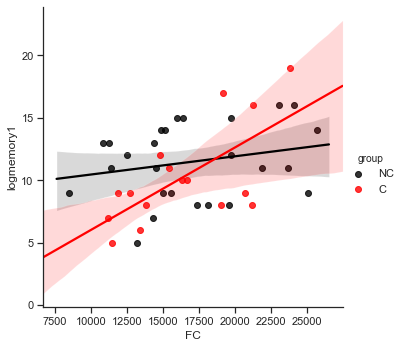

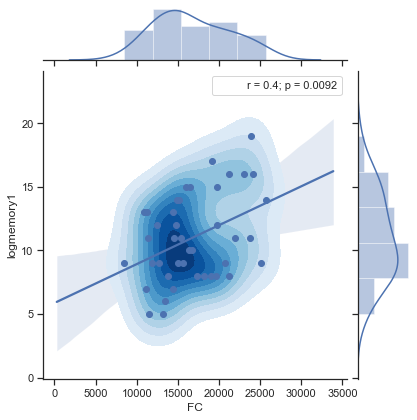

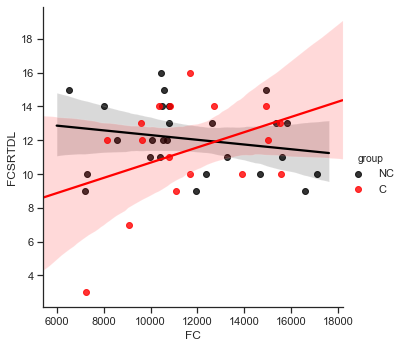

...

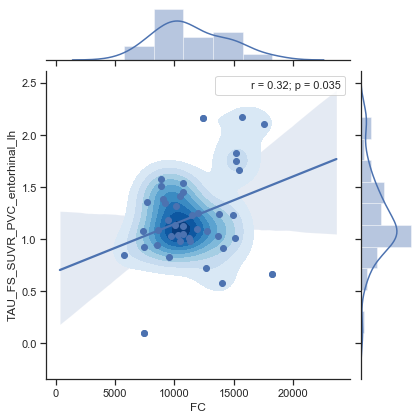

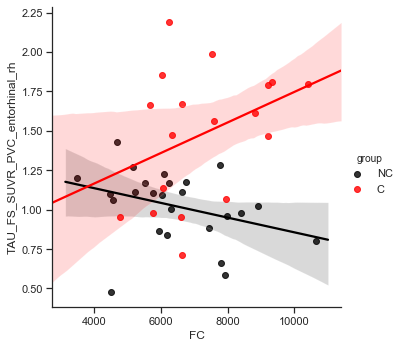

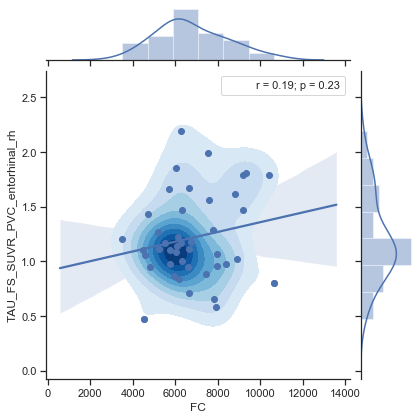

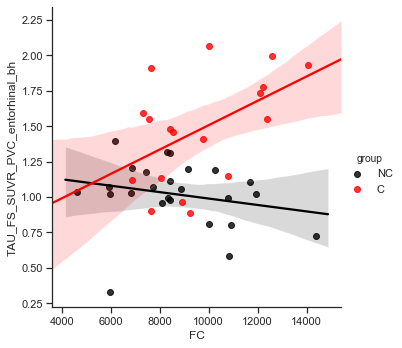

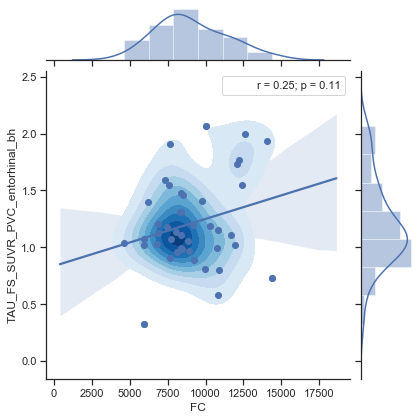

In [20]:
col_s_names = sig_dif.col_name.unique()
coords= yeo_cords_no_limbic.iloc[:, 2:5].values

def r(x, y):
    return stats.pearsonr(x, y)


for i in range(1,len(col_s_names )):
 
  data = sig_dif[sig_dif.col_name==col_s_names[i]]

  lm_fc_scr=sns.lmplot(x="fc", y="beh", hue= "group",
                     palette=['black','red'], sharex=False,sharey=False,data=data)
  
  g = sns.jointplot(x="fc", y="beh", data= data, kind="reg",dropna=True, stat_func=r)
  g.plot_joint(sns.kdeplot, shade=True, cmap='Blues', shade_lowest=False)
  g.plot_joint(plt.scatter)
  g.set_axis_labels("FC", col_s_names[i])
  lm_fc_scr.set_axis_labels("FC", col_s_names[i])





  

## PLOTTINGS OF MASKED CONNECTIVITY MATRIX FOR GROUP 2, STATISTICALLY SIGNIFICANT BEH VARIABLES

In [21]:
import nilearn
from nilearn import plotting

In [22]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[0]]
group_2_index = np.where(df_corr["group"].values[0]==2)
corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[0], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')





***************** wllrecall ***********************


In [23]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[1]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[1], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** mctfreerecall ***********************


In [24]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[2]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[2], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** logmemory1 ***********************


In [25]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[3]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[3], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** FCSRTDL ***********************


In [26]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[4]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[4], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** FCSRTDF ***********************


In [27]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[5]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[5], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** FASTot ***********************


In [28]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[6]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[6], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** IneTot30 ***********************


In [29]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[7]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[7], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** TAU_FS_SUVR_PVC_entorhinal_lh ***********************


In [30]:
df_corr = all_corr_th[all_corr_th.colname==col_s_names[8]]
group_2_index = np.where(df_corr["group"].values[0]==2)

corr_group_2 = np.take(df_corr["corr_matrix"].values[0], group_2_index[0], 2)
strength_group_2 = np.take(df_corr["strenght"].values[0], group_2_index[0], 1)
mean_corr_group_2 = corr_group_2.mean(axis=2)
mean_strength_group_2 = strength_group_2.mean(axis=1)
print("*****************",col_s_names[8], "***********************" )
plotting.view_connectome(mean_corr_group_2, coords, node_size= mean_strength_group_2,edge_threshold='99.9%')

***************** TAU_FS_SUVR_PVC_entorhinal_rh ***********************


## MODEL BY NODE

In [31]:
node_model = pd.DataFrame(columns={'col_name','p_values_uncorrected','p_vals_corrected', 'reject','group'})
for j in range(1,len(col_s_names)):
    df_s = all_corr_th[all_corr_th.colname==col_s_names[j]]
    group_index = np.where((df_s["group"].values[0]!=3) & (df_s["group"].values[0]!=0))

    corr_matrix = np.take(df_s["corr_matrix"].values[0], group_index[0], 2)
    strength = np.take(df_s["strenght"].values[0], group_index[0], 1)
    str_behav= np.take(df_s["str_behav"].values[0], group_index[0], 0)
    group = np.take(df_s["group"].values[0], group_index[0], 0)

    p_values_uncorrected = []

    for i in range(1,strength.shape[0]):
        data = pd.DataFrame({"st_node": strength[i,:], "GROUP": group, "beh": str_behav}).astype('float64')
        result = ols(formula='beh ~ st_node + GROUP + st_node* GROUP', data=data).fit()
        p_values_uncorrected.append(result.pvalues["st_node:GROUP"])

    reject, p_vals_corrected = pg.multicomp(p_values_uncorrected, alpha=0.05, method='bonf')
    model_df = pd.DataFrame([{'p_values_uncorrected': np.asarray(p_values_uncorrected) , 'p_vals_corrected': np.array(p_vals_corrected, dtype=float), 'reject': reject ,'col_name': [col_s_names[j]]}]) 
    node_model = pd.concat([node_model, model_df], ignore_index = True)  
    

In [32]:
all_corr_th.head()

,colname,corr_matrix,group,str_behav,strenght
0,SEX,"[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0, 3.0, ...","[2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 1, 1, ...","[[67.94702456500858, 48.540601118539826, 97.23..."
1,EDU,"[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0, 3.0, ...","[16, 7, 11, 16, 11, 12, 5, 11, 5, 13, 9, 5, 15...","[[65.53792854382368, 48.20984023681717, 99.466..."
2,AGE,"[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0, 3.0, ...","[40, 35, 33, 35, 30, 44, 37, 32, 43, 42, 40, 3...","[[35.05773022086615, 26.220674212201313, 61.79..."
3,mmsememory,"[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0, 3.0, ...","[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,mmserecall,"[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0, 3.0, ...","[3, 1, 1, 2, 2, 2, 2, 2, 0, 0, 2, 1, 2, 1, 2, ...","[[59.81643535225997, 46.01899543667746, 118.95..."


## Model by node for group 2


In [33]:
from multipy.fwer import sidak
from multipy.fwer import hochberg
from multipy.fwer import holm_bonferroni
from multipy.permutation import permutation_test

node_model_2 = pd.DataFrame(columns={'col_name','p_values_uncorrected','p_vals_corrected','group','any_p'})
for j in range(0,len(col_s_names)):
    df_s = all_corr_th[all_corr_th.colname==col_s_names[j]]
    group_index = np.where(df_s["group"].values[0]==2)
    corr_matrix = np.take(df_s["corr_matrix"].values[0], group_index[0], 2)
    strength = np.take(df_s["strenght"].values[0], group_index[0], 1)
    str_behav= np.take(df_s["str_behav"].values[0], group_index[0], 0)
    group = np.take(df_s["group"].values[0], group_index[0], 0)
    p_values_uncorrected = []

    print(col_s_names[j])

    for i in range(1,strength.shape[0]):
        data = pd.DataFrame({"st_node": strength[i,:], "GROUP": group, "beh": str_behav}).astype('float64') 
        X = strength[i,:]
        Y = str_behav.astype(int)
        result = pg.linear_regression(X,Y)
        p_values_uncorrected.append(result.pval[1])
        
    p_vals_corrected = sidak(p_values_uncorrected, alpha=0.05)
    p_index = np.where(np.asarray(p_values_uncorrected) < 0.05)
    p_index_corrected = np.where(np.asarray(p_vals_corrected) == 1)
    model_df = pd.DataFrame([{'p_values_uncorrected': np.asarray(p_values_uncorrected) , 'p_vals_corrected': np.array(p_vals_corrected, dtype=float),'col_name': col_s_names[j], 'group': group, 'any_p': p_vals_corrected.any(), 'p_index': p_index, 'p_index_corrected': p_index_corrected }]) 
    node_model_2 = pd.concat([node_model_2, model_df], ignore_index = True)  

wllrecall
mctfreerecall
logmemory1
FCSRTDL
FCSRTDF
FASTot
IneTot30
TAU_FS_SUVR_PVC_entorhinal_lh
TAU_FS_SUVR_PVC_entorhinal_rh
TAU_FS_SUVR_PVC_entorhinal_bh


In [34]:
df_s = all_corr_th[all_corr_th.colname==col_s_names[6]]
group_index = np.where(df_s["group"].values[0]==2)
corr_matrix = np.take(df_s["corr_matrix"].values[0], group_index[0], 2)
strength = np.take(df_s["strenght"].values[0], group_index[0], 1)
str_behav= np.take(df_s["str_behav"].values[0], group_index[0], 0)
group = np.take(df_s["group"].values[0], group_index[0], 0)
p_values_uncorrected = []

group_index


(array([ 1,  2,  4,  6, 11, 15, 17, 19, 20, 22, 25, 33, 34, 37, 38, 41, 45]),)

In [35]:
from collections import Counter
def print_nodes_and_hist(ind,node_model_2,networks,coords):
    df_corr = node_model_2[node_model_2.col_name==col_s_names[ind]]
    any_p = df_corr["any_p"].any()
    p_index = df_corr["p_index"]
    len_p = len(p_index.values[0][0])
    color = ['gray']*len_p
    p_index_corrected = df_corr["p_index_corrected"]
    var = [p_index.values[0][0].tolist().index(i) for i in p_index.values[0][0] if i in p_index_corrected.values[0][0]]
    cords = coords[np.asarray(p_index.values[0][0])]
   
    for i in var:
        color[i] = 'orange'
       
    print(coords[np.asarray(p_index.values[0][0])].shape)
    print("*****************",col_s_names[ind], "***********************" )

    p_networks = networks[np.asarray(p_index.values[0][0])]
    p_networks_c = np.concatenate( p_networks, axis=0)
    network_list = [item.split("_")[2] for item in p_networks_c ]
    network_count = Counter(network_list)
    plt.bar(network_count.keys(), network_count.values(), color="gray")

    if any_p:
        p_corrected = networks[np.asarray(p_index_corrected.values[0][0])]
        p_networks_corrected_c = np.concatenate( p_corrected, axis=0)
        network_list_corrected = [item.split("_")[2] for item in p_networks_corrected_c]
        network_corrected_count = Counter(network_list_corrected)
        plt.bar(network_corrected_count.keys(), network_corrected_count.values(), color="orange")
    
    return cords, color 
    


In [38]:
nilearn.plotting.view_markers(cords, marker_color=color, marker_size=6.0, title=None, title_fontsize=25)


(19, 3)
(43, 3)
(175, 3)
(25, 3)
(22, 3)
(194, 3)
(77, 3)
(89, 3)
(15, 3)
(9, 3)


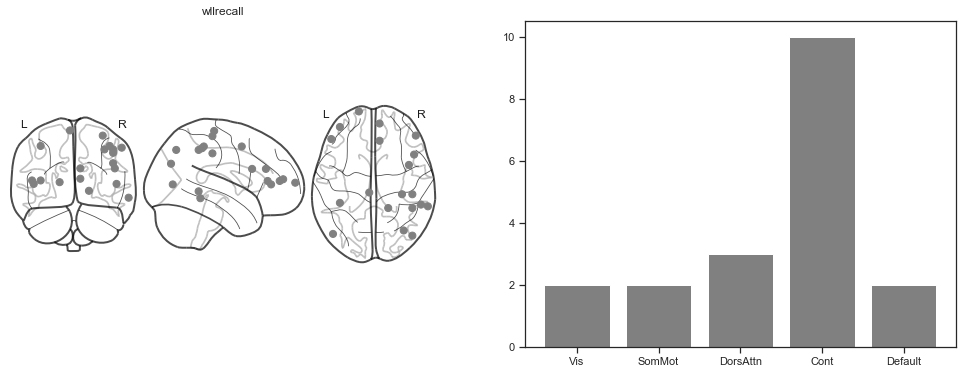

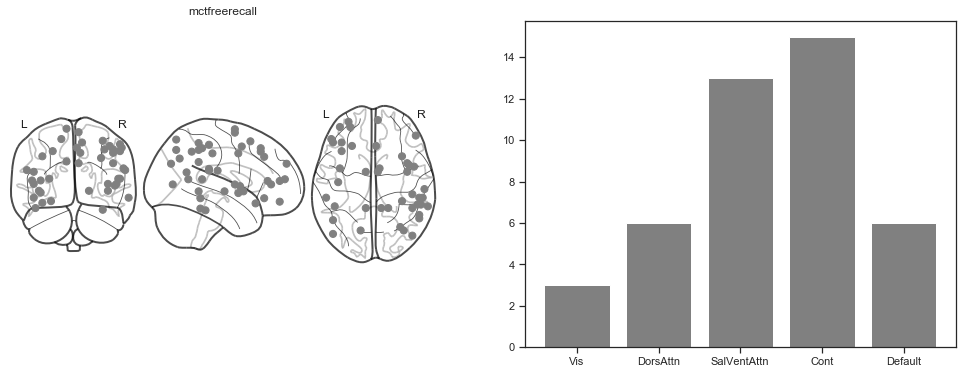

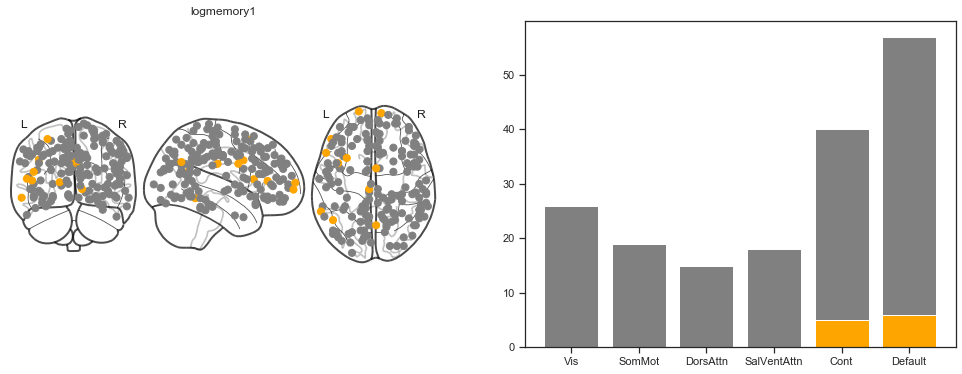

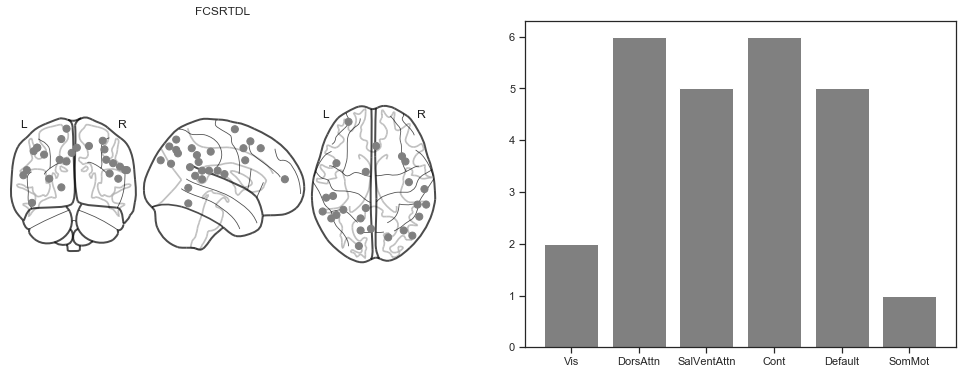

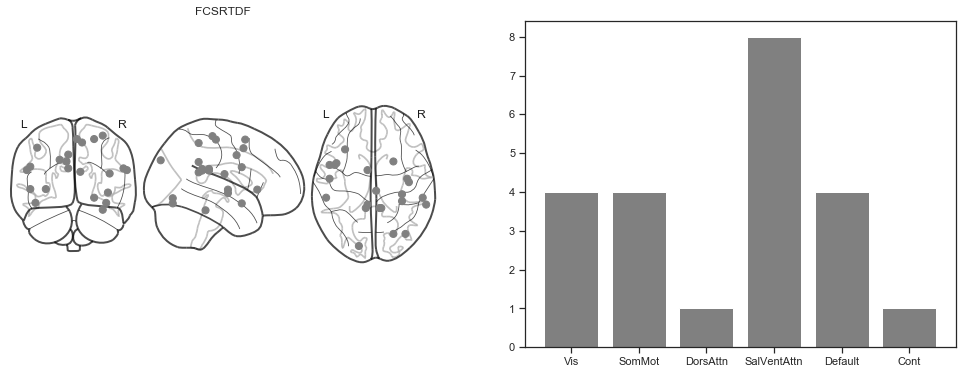

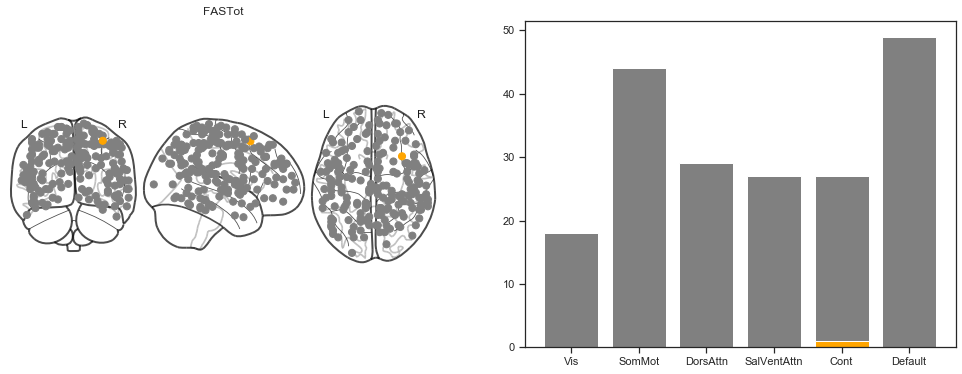

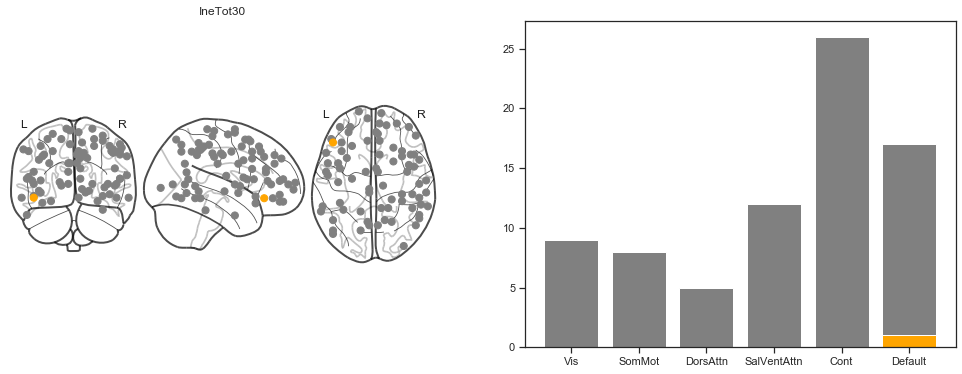

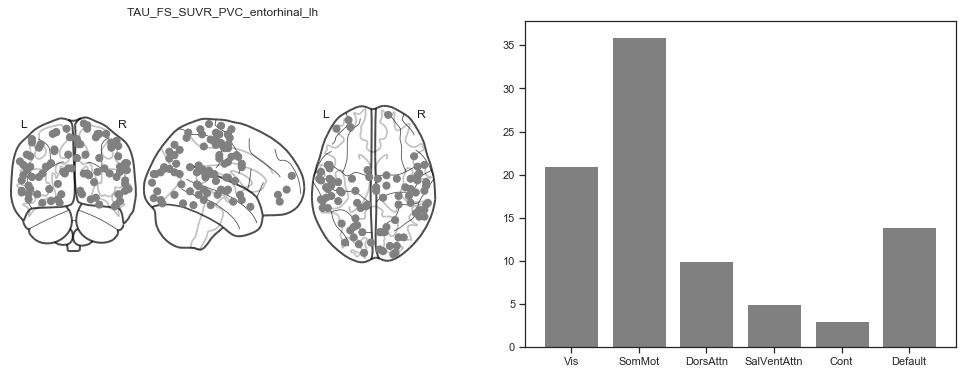

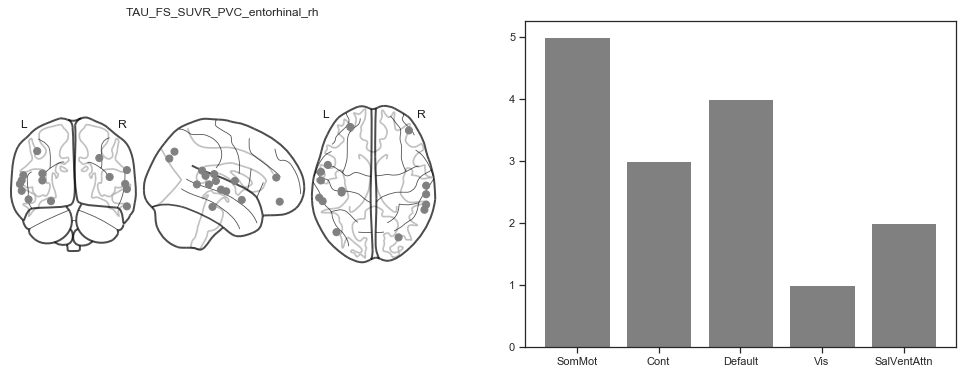

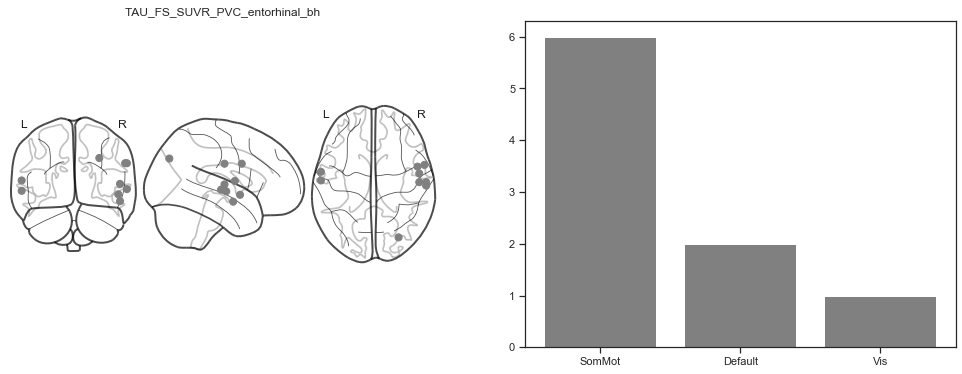

In [135]:
for j in range(len(node_model_2)): 
    df_corr = node_model_2[node_model_2.col_name==col_s_names[j]]
    any_p = df_corr["any_p"].any()
    p_index = df_corr["p_index"]
    len_p = len(p_index.values[0][0])
    color = ['gray']*len_p
    p_index_corrected = df_corr["p_index_corrected"]
    var = [p_index.values[0][0].tolist().index(i) for i in p_index.values[0][0] if i in     p_index_corrected.values[0][0]]
    cords = coords[np.asarray(p_index.values[0][0])]
   
    for i in var:
        color[i] = 'orange'
       
    print(coords[np.asarray(p_index.values[0][0])].shape)

    cords_l = [tuple(map(int, cor)) for cor in cords]
    ad_ma = np.zeros((len(cords_l), len(cords_l)))

    fig = plt.figure(figsize = (17,6))
    ax1 = fig.add_subplot(1,2,1)
    ax1.set_title(col_s_names[j])
    nilearn.plotting.plot_connectome(ad_ma,cords_l, node_color=color, axes=ax1)

    p_networks = networks[np.asarray(p_index.values[0][0])]
    p_networks_c = np.concatenate( p_networks, axis=0)
    network_list = [item.split("_")[2] for item in p_networks_c ]
    network_count = Counter(network_list)
    ax2 = fig.add_subplot(1,2,2)
    plt.bar(network_count.keys(), network_count.values(), color="gray")

    if any_p:
        p_corrected = networks[np.asarray(p_index_corrected.values[0][0])]
        p_networks_corrected_c = np.concatenate( p_corrected, axis=0)
        network_list_corrected = [item.split("_")[2] for item in p_networks_corrected_c]
        network_corrected_count = Counter(network_list_corrected)
        plt.bar(network_corrected_count.keys(), network_corrected_count.values(), color="orange")